[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/MikeS96/cv_dl/blob/main/lab1/CVwDL_Laboratorio_1pt_1.ipynb)

# <font color='blue'>**LABORATORIO 1. VISIÓN COMPUTACIONAL CLÁSICA**


Adicione el código necesario para resolver todas las preguntas resaltadas en rojo.

<font color='blue'>**(40%) Problema  1. STITCHING** 

Cuando se realiza el escaneo de imágenes medicas de manera automática,  puede ocurrir un problema asociado al hecho de que estas imágenes han sido tomadas con una cámara en movimiento, por lo que resulta muy probable que se presente superposición entre imágenes adyacentes (horizontales y verticales).  

<font color='green'>(20%) 1a. Use SURF y SIFT  para crear la imagen completa producida por el escaneo. Use el conjunto de imágenes adjuntas (stitiching.zip).

<font color='green'>(20%) 1b. Realice una comparativa  de los descriptores usados.  Tenga en cuenta que el emparejamiento siempre se hace entre dos imágenes. Use las siguientes características: Features Imagen 1, Features Imagen 2, Tiempo usado por el detector/descriptor, Cantidad de features emparejadas, MSE, PSNR. ( En este [articulo](https://www.astesj.com/publications/ASTESJ_040217.pdf), pueden observar  en detalle como se realiza el comparativo.  ¿Cómo podría usarse MSE  y/o PSNR en este caso especifico?

<font color='green'>1c. Realice sus propias conclusiones.

# SIFT

## 1.a Install dependencies
Install OpenCV version 4.4.0.44 in order to use SIFT methods.

In [ ]:
!pip install opencv-contrib-python==4.4.0.44
!pip install rich

     |████████████████████████████████| 55.7MB 72kB/s 
  Found existing installation: opencv-contrib-python 4.1.2.30
    Uninstalling opencv-contrib-python-4.1.2.30:
      Successfully uninstalled opencv-contrib-python-4.1.2.30
     |████████████████████████████████| 204kB 5.0MB/s 
     |████████████████████████████████| 51kB 4.5MB/s 


## Load images

Import necessary libraries for incoming processes such as feature extraction, SIFT computation, features matching and load all images in sequence for stitching.

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
import cv2
import os

from rich.console import Console
from rich.table import Table
import time

# Base path
dir_base = 'stitching'
# Reading images

images = []
filesnames = os.listdir(dir_base)
filesnames.sort()
filesnames[12:] = filesnames[12:][::-1]
# How to pass through images
filesnames = ['img_7_21.jpeg',
              'img_8_21.jpeg',
              'img_8_22.jpeg',
              'img_7_22.jpeg',
              'img_7_23.jpeg',
              'img_8_23.jpeg',
              'img_8_24.jpeg',
              'img_7_24.jpeg',
              'img_7_25.jpeg',
              'img_8_25.jpeg',
              'img_8_26.jpeg',
              'img_7_26.jpeg',
              'img_7_27.jpeg',
              'img_8_27.jpeg',
              'img_8_28.jpeg',
              'img_7_28.jpeg',
              'img_7_29.jpeg',
              'img_8_29.jpeg',
              'img_8_30.jpeg',
              'img_7_30.jpeg',
              'img_7_31.jpeg',
              'img_8_31.jpeg',
              'img_8_32.jpeg',
              'img_7_32.jpeg']

for file in filesnames:
  if file == 'stitch_output.jpg':
    continue
  img = cv2.imread(os.path.join(dir_base, file))
  images.append(img)

## Extract features of all images
Based on the function name sent, this method will compute that function for all images passsed, returning a list with keypoints and descriptions for each image.

In [ ]:
def extract_features_dataset(images, extract_features_function):
    kp_list = []
    des_list = []
        
    for image in images:
        kp, des = extract_features_function(image)
        
        kp_list.append(kp)
        des_list.append(des)
    
    return kp_list, des_list

## Method to compute SIFT
This cell instantiates SIFT object to use in the feature extrator, this method will compute with SIFT the keypoints and descriptions for a single image in gray scale.

In [ ]:
sift = cv2.SIFT.create()

def extract_features_sift(image):
    img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    kp, des = sift.detectAndCompute(img_gray, None)

    return kp, des

The method ```extract_features_dataset``` is called indicating that the function ```extract_features_sift``` will be used to process all images previously loaded.

In [ ]:
#%time
kp_list_sift, des_list_sift = extract_features_dataset(images, extract_features_sift)

In [ ]:
i = 1
print("Number of features detected in frame {0}: {1}".format(i, len(kp_list_sift[i])))
print("Coordinates of the first keypoint in frame {0}: {1}\n".format(i, str(kp_list_sift[i][0].pt)))
print("Length of images array: {0}".format(len(images)))

print("Number of SIFT objects computed, detectors: {} descriptors: {}".format(len(des_list_sift), len(kp_list_sift)))

Number of features detected in frame 1: 831
Coordinates of the first keypoint in frame 1: (16.235475540161133, 166.7125701904297)

Length of images array: 24
Number of SIFT objects computed, detectors: 24 descriptors: 24


## Compute matches over a pair of images
This method will use the descriptors from 2 different images and a Flann matcher, to find the best matches between the descriptors, based on the distance ratio indicated.

In [ ]:
def match_features(des1, des2, distance_ratio = 0.80): 
  flann_params = dict(algorithm = 1, trees = 5)
  search_params = dict(checks = 50)
  flann = cv2.FlannBasedMatcher(flann_params, search_params)
  matches = flann.knnMatch(des1, des2, k = 2)
  matches_good = []
  for m, n in matches:
    if m.distance < distance_ratio * n.distance:
      matches_good.append(m)
  return matches_good

In [ ]:
def match_features_bfm(des1, des2, distance_ratio = 0.80): 
  fbm = cv2.BFMatcher(cv2.NORM_L2, crossCheck = True)
  matches = fbm.match(des1, des2)
  return matches

Number of features matched in frames 1 and 2 before filtering by distance: 99


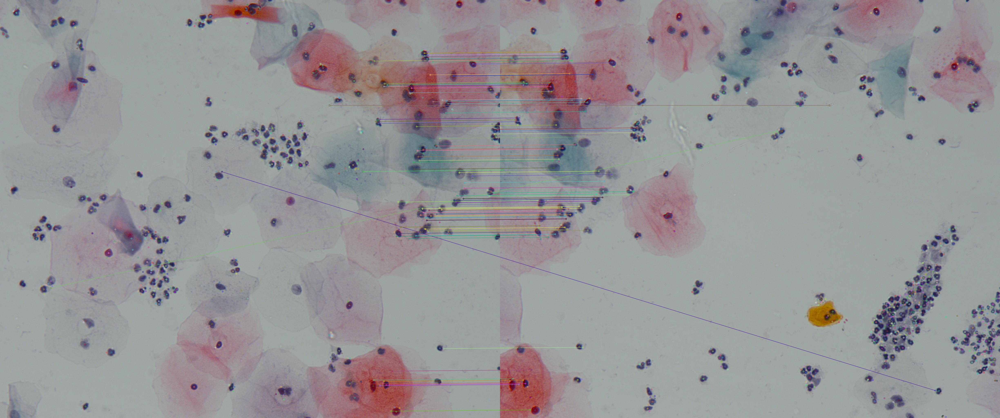

In [ ]:
i = 1
des1 = des_list_sift[i]
des2 = des_list_sift[i+1]

distance_ratio = 0.65
match = match_features(des1, des2, distance_ratio)
#match = match_features_bfm(des1, des2, distance_ratio)

print("Number of features matched in frames {0} and {1} before filtering by distance: {2}".format(i, i+1, len(match)))

res = cv2.drawMatches(images[i], kp_list_sift[i], images[i+1], kp_list_sift[i+1], match, None)
cv2_imshow(res)

## Compute matches over all images

This method will find the best matches using the function ```match_features``` sending the current image and the next, for example: for image 2 and 3, then for image 3 and 4 and so on.

In [ ]:
def match_features_dataset(images, des_list, match_features, distance_ratio = 0.8):
    matches = []
    
    for i in range(len(images) - 1):
        des1 = des_list[i]
        des2 = des_list[i + 1]
        match = match_features(des1, des2, distance_ratio)
        matches.append(match)

    return matches

In [ ]:
# Number between 0 - 1, values closer to cero are less matches. Between 0.6 and 0.75 works fine.
distance_ratio = 0.7
matches = match_features_dataset(images, des_list_sift, match_features, distance_ratio)
#matches = match_features_dataset(images, des_list_sift, match_features_bfm, distance_ratio)

i = 1
print("Number of features matched in frames {0} and {1}: {2}".format(i, i+1, len(matches[i])))

Number of features matched in frames 1 and 2: 112


## Compute size of new canvas
This method will find the corners to create the new canvas in order to stitch the base image with the next one.

In [ ]:
def compute_boundaries(corners_1, corners_2):
  # Concatenate all points (base image and next image mapped)
  all_points = np.concatenate((corners_1,corners_2), axis=0)
  # Compute size of new image
  [x_min, y_min] = np.int32(all_points.min(axis=0) - 0.5)
  [x_max, y_max] = np.int32(all_points.max(axis=0) + 0.5)
  return x_min, y_min, x_max, y_max

## Compute homography and stitch images

This loop aims to create the final stitching. It is based on homography computations of the "next" image in order to calculate the size of the canvas at each iteration to avoid memory overflows. 

An empty canvas is create at each iteration with the maximum (**x, y**) size found based on the previous canvas and the next image to add mapped with the homography in the "canvas". The images are added in the canvas in a masked fashioned where the first image is added with a mask that avoids copying pixels that overlap with the next image. Finally the "next image" is directly added to the canvas without masking.

The homography matrices are stacked up at each iteration considering that the images follow a consecutive pattern. These are stored in the variable *H_i*. The final result is saved in a temporal variable as it is not possible to show it due to memory constrains. 

In [ ]:
MIN_MATCH_COUNT = 10

# Identity matrix to concatenate homography
H_i = np.eye(3)
# Base image
base_image = images[0].copy()

stitching_time_sift = 0
for i in range(len(images) - 1):
  start = time.time()
  match = matches[i]
  kp1 = kp_list_sift[i]
  kp2 = kp_list_sift[i + 1]
  # Dst image
  img_dst = images[i + 1]
  # Corners of image dst
  dst_height, dst_width = img_dst.shape[:2]
  dst_corners = np.float32([[0, 0], [0, dst_height], [dst_width, dst_height], 
                           [dst_width, 0]]).reshape(-1,1,2)
  # Corners of image src
  src_height, src_width = base_image.shape[:2]
  src_corners = np.float32([[0, 0], [0, src_height], [src_width, src_height], 
                           [src_width, 0]]).reshape(4,-1)

  if len(match) > MIN_MATCH_COUNT:
    # Fuente es Query, destino es train
    # queryIdx are for kp1 and trainIdx for kp2 generates error
    src_pts = np.float32([kp1[m.queryIdx].pt for m in match]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in match]).reshape(-1, 1, 2)
    # RANSAC Threshold 5
    H, status = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, 5.0)
    # Concatenating homography
    H_i = H_i.dot(H)
    # Obtain position of the next image in Canvas
    dst_corners = cv2.perspectiveTransform(dst_corners, H_i).reshape(4, -1)
    # Coordinates of the new canvas
    x_min, y_min, x_max, y_max = compute_boundaries(src_corners, dst_corners)
    # Compute Homography for traslation in new canvas
    H_traslation = np.eye(3)
    if ( x_min < 0 ):
      H_traslation[0,2] += -x_min
      # This is the X dimension of the new image
      x_max += -x_min
    if ( y_min < 0 ):
      H_traslation[1,2] += -y_min
      # This is the Y dimension of the new image
      y_max += -y_min
    # Create canvas with new image size
    height = y_max
    width = x_max
    print('The currend height of the canvas is:  {} and the width is: {}'.format(height, width))
    # New canvas 
    img_panorama = np.zeros((height, width, 3))
    # Translate base image in new canvas
    base_image = cv2.warpPerspective(src = base_image, M = H_traslation, dsize = (width, height))
    # Concatenate traslation to homographies
    H_i = H_i.dot(H_traslation)
    # Map next image to new canvas
    next_image = cv2.warpPerspective(src = img_dst, M = H_i, dsize = (width, height))
    # Create mask to add images
    (ret, mask) = cv2.threshold(cv2.cvtColor(next_image, cv2.COLOR_BGR2GRAY), 0, 255, cv2.THRESH_BINARY)
    # Add base image to canvas
    img_panorama = cv2.add(img_panorama, base_image, mask = np.bitwise_not(mask), dtype = cv2.CV_8U)
    # Add next image to canvas
    result = cv2.add(img_panorama, next_image, dtype = cv2.CV_8U)
    base_image = result.copy()
    end = time.time()
    stitching_time_sift += end - start

cv2.imwrite('final_image_sift.jpg', base_image) 
print('Image stored!!!')

The currend height of the canvas is:  3546 and the width is: 2926
The currend height of the canvas is:  3569 and the width is: 4255
The currend height of the canvas is:  3659 and the width is: 4843
The currend height of the canvas is:  3681 and the width is: 6771
The currend height of the canvas is:  3741 and the width is: 6771
The currend height of the canvas is:  3787 and the width is: 8073
The currend height of the canvas is:  3787 and the width is: 8744
The currend height of the canvas is:  3828 and the width is: 10846
The currend height of the canvas is:  4061 and the width is: 10846
The currend height of the canvas is:  4164 and the width is: 12472
The currend height of the canvas is:  4184 and the width is: 13119
The currend height of the canvas is:  4210 and the width is: 15607
The currend height of the canvas is:  4332 and the width is: 15607
The currend height of the canvas is:  4457 and the width is: 17605
The currend height of the canvas is:  4457 and the width is: 18247
Th

## Best image SIFT

This was the best result obtained with a distance ratio of *0.6*. Nevertheless, it is important to recall that at every new execution, the features change as the descriptors and mathes. Therefore, we recommend to execute the code with a distance ratio of *0.7* which seems to produce the most *stable* stitch.

The image can be downloaded [here](https://github.com/MikeS96/cv_dl/blob/main/lab1/assets/best_image_sift.jpg). 

## 1.b Data for comparison

This section is used to find the data to compare both descriptors; number of features computed for 2 images, time required for this computation and matched features.

## Comparison of images

In [ ]:
# Set table
table = Table(title="Comparison SIFT")

table.add_column("Descriptor", justify="center", style="cyan", no_wrap=True)
table.add_column("Images Size", style="magenta")
table.add_column("Keypoints image 1", style="magenta")
table.add_column("Keypoints image 2", style="magenta")
table.add_column("Execution time (s)", style="magenta")
table.add_column("Matches", justify="center", style="green")

total_time = 0
distance_ratio = 0.6

list_matches = []
list_kp1 = []
list_kp2 = []

for idx in range(len(images) - 1):
  start = time.time()
  kp1, des1 = extract_features_sift(images[idx])
  kp2, des2 = extract_features_sift(images[idx + 1])
  match = match_features(des1, des2, distance_ratio)
  end = time.time()
  table.add_row("SIFT", '{}'.format(images[idx].shape[:2]), '{}'.format(len(kp1)), '{}'.format(len(kp2)), 
                '{}'.format(round(end - start, 2)), '{}'.format(len(match)))
  total_time += end - start
  list_kp1.append(len(kp1))
  list_kp2.append(len(kp2))
  list_matches.append(len(match))

table.add_row('', '', '{}'.format(round(sum(list_kp1) / len(list_kp1), 2)), '{}'.format(round(sum(list_kp2) / len(list_kp2), 2)), '{}'.format(round(total_time, 2)), 
              '{}'.format(round(sum(list_matches) / len(list_matches), 2)))
console = Console()
console.print(table)

                                Comparison SIFT                                 
┏━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Descriptor ┃ Images Size ┃ Keypoints   ┃ Keypoints   ┃ Execution   ┃ Matches ┃
┃            ┃             ┃ image 1     ┃ image 2     ┃ time (s)    ┃         ┃
┡━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━┩
│    SIFT    │ (2048,      │ 786         │ 831         │ 2.91        │   55    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 831         │ 1174        │ 2.6         │   99    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 1174        │ 786         │ 2.66        │   105   │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 786         │ 403         │ 2.53        │   51    │
│            │ 2448)       │

## MSE Performance

The MSE was computing using the distance between pixels. This was done through the homography matrix, mapping the points of the next image to base image. The mapped points should be exactly the same as the ones from the base image as we are only mapping the *matches* between both images.

The MSE equation used is the one shown as follows:

$ MSE = \frac{1}{n}\sum_{t=1}^{n}(y - \hat{y})^2$ 

where $n$ are the number of matches between both images, $y$ are the points in the base image and $\hat{y}$ are the points in the next image. Additionally, the PSNR was also computed using the next equation.

$ PSNR = 10 log_{10} \frac{MAX^2_I}{MSE} $

It is important to mention that in this particular case, we computed the MSE over the $Norm$ of a point, the $x$ pixel value and the $y$ pixel value. That was with the intention to see which was the greatest source of error. The variable $MAX^2_I$ for the *norm* case if the maximum value of the norm given the image size, for *x* is the width of the image and for *y* is the height.

**Note:** The Errors were computed only using the inliers. As computing the MSE with the outliers lead to extremelly high error in the order of thousands as the difference was considerably increased by the MSE calculation.

In [ ]:
MIN_MATCH_COUNT = 10

# Set table magnitude
table_m = Table(title = "MSE magnitude Error using SIFT")

table_m.add_column("Images", justify="center", style="cyan", no_wrap=True)
table_m.add_column("MSE (px)", justify="center", style="magenta", no_wrap=True)
table_m.add_column("PSNR (dB)", justify="center", style="magenta", no_wrap=True)
table_m.add_column("Total time (s)", justify="center", style="green", no_wrap=True)
# Set table x
table_x = Table(title = "MSE X Error using SIFT")

table_x.add_column("Images", justify="center", style="cyan", no_wrap=True)
table_x.add_column("MSE (px)", justify="center", style="magenta", no_wrap=True)
table_x.add_column("PSNR (dB)", justify="center", style="magenta", no_wrap=True)
table_x.add_column("Total time (s)", justify="center", style="green", no_wrap=True)
# Set table Y
table_y = Table(title = "MSE Y Error using SIFT")

table_y.add_column("Images", justify="center", style="cyan", no_wrap=True)
table_y.add_column("MSE (px)", justify="center", style="magenta", no_wrap=True)
table_y.add_column("PSNR (dB)", justify="center", style="magenta", no_wrap=True)
table_y.add_column("Total time (s)", justify="center", style="green", no_wrap=True)

total_mse_m = 0
total_mse_x = 0
total_mse_y = 0
total_psnr_m = 0
total_psnr_x = 0
total_psnr_y = 0

for i in range(len(images) - 1):
  match = matches[i]
  kp1 = kp_list_sift[i]
  kp2 = kp_list_sift[i + 1]
  inliers_dst = []
  inliers_src = []

  if len(match) > MIN_MATCH_COUNT:
    # Fuente es Query, destino es train
    # queryIdx are for kp1 and trainIdx for kp2 generates error
    src_pts = np.float32([kp1[m.queryIdx].pt for m in match]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in match]).reshape(-1, 1, 2)
    # RANSAC Threshold 5
    H, status = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, 5.0)
    # Obtain only the inliers used to compute Homography
    for id_mask, dst_pt, src_pt in zip(status, dst_pts, src_pts):
      if id_mask.ravel() == 1:
        inliers_dst.append(dst_pt.ravel())
        inliers_src.append(src_pt.ravel())
    # Append inliers
    src_pts = np.array(inliers_src).reshape(-1, 1, 2)
    dst_pts = np.array(inliers_dst).reshape(-1, 1, 2)
    # Transform points to base
    dst_pts2src = cv2.perspectiveTransform(dst_pts, H).reshape(-1, 2)
    src_pts = src_pts.reshape(-1, 2)
    MSE_M = (sum(np.square(np.linalg.norm(dst_pts2src, axis = 1) - np.linalg.norm(src_pts, axis = 1)))) / src_pts.shape[0]
    MSE_X = (sum(np.square(dst_pts2src[:, 0] - src_pts[:, 0]))) / src_pts.shape[0]
    MSE_Y = (sum(np.square(dst_pts2src[:, 1] - src_pts[:, 1]))) / src_pts.shape[0]
    # Computing max values
    im_height = images[0].shape[1]
    im_width = images[0].shape[0]
    im_norm = np.linalg.norm([images[0].shape[1], images[0].shape[0]])
    # Computing PSNR
    PSNR_M = 10 * np.log10(np.square(im_norm) / MSE_M)
    PSNR_X = 10 * np.log10(np.square(im_width) / MSE_X)
    PSNR_Y = 10 * np.log10(np.square(im_height) / MSE_Y)
    total_mse_m += MSE_M
    total_mse_x += MSE_X
    total_mse_y += MSE_Y
    total_psnr_m += PSNR_M
    total_psnr_x += PSNR_X
    total_psnr_y += PSNR_Y
    table_m.add_row("Image {} and {}".format(i, i+1), '{}'.format(round(MSE_M, 2)), '{}'.format(round(PSNR_M, 2)), '{}'.format(''))
    table_x.add_row("Image {} and {}".format(i, i+1), '{}'.format(round(MSE_X, 2)), '{}'.format(round(PSNR_X, 2)), '{}'.format(''))
    table_y.add_row("Image {} and {}".format(i, i+1), '{}'.format(round(MSE_Y, 2)), '{}'.format(round(PSNR_Y, 2)), '{}'.format(''))

table_m.add_row("{}".format(''), '{}'.format(round(total_mse_m / (len(images) - 1), 2)), '{}'.format(round(total_psnr_m / (len(images) - 1), 2)), '{}'.format(round(stitching_time_sift, 2)))
table_x.add_row("{}".format(''), '{}'.format(round(total_mse_x / (len(images) - 1), 2)), '{}'.format(round(total_psnr_x / (len(images) - 1), 2)), '{}'.format(round(stitching_time_sift, 2)))
table_y.add_row("{}".format(''), '{}'.format(round(total_mse_y / (len(images) - 1), 2)), '{}'.format(round(total_psnr_y / (len(images) - 1), 2)), '{}'.format(round(stitching_time_sift, 2)))
# Printing
console = Console()
console.print(table_m)
console.print(table_x)
console.print(table_y)

# SURF

## 1.a Install dependencies
Install OpenCV version 3.4.2.17 in order to use SURF methods.

In [ ]:
!pip install opencv-contrib-python==3.4.2.17
!pip install rich

     |████████████████████████████████| 30.6MB 133kB/s 
  Found existing installation: opencv-contrib-python 4.4.0.44
    Uninstalling opencv-contrib-python-4.4.0.44:
      Successfully uninstalled opencv-contrib-python-4.4.0.44


## Load images
Import necessary libraries for incoming processes such as feature extraction, SURF computation, features matching and load all images in sequence for stitching.

In [ ]:
import numpy as np
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
import cv2
import os

from rich.console import Console
from rich.table import Table
import time

# Base path
dir_base = 'stitching'
# Reading images

images = []
filesnames = os.listdir(dir_base)
filesnames.sort()
filesnames[12:] = filesnames[12:][::-1]
filesnames = ['img_7_21.jpeg',
              'img_8_21.jpeg',
              'img_8_22.jpeg',
              'img_7_22.jpeg',
              'img_7_23.jpeg',
              'img_8_23.jpeg',
              'img_8_24.jpeg',
              'img_7_24.jpeg',
              'img_7_25.jpeg',
              'img_8_25.jpeg',
              'img_8_26.jpeg',
              'img_7_26.jpeg',
              'img_7_27.jpeg',
              'img_8_27.jpeg',
              'img_8_28.jpeg',
              'img_7_28.jpeg',
              'img_7_29.jpeg',
              'img_8_29.jpeg',
              'img_8_30.jpeg',
              'img_7_30.jpeg',
              'img_7_31.jpeg',
              'img_8_31.jpeg',
              'img_8_32.jpeg',
              'img_7_32.jpeg']

for file in filesnames:
  if file == 'stitch_output.jpg':
    continue
  img = cv2.imread(os.path.join(dir_base, file))
  images.append(img)

## Extract features of all images
Based on the function name sent, this method will compute that function for all images passsed, returning a list with keypoints and descriptions for each image.

In [ ]:
def extract_features_dataset(images, extract_features_function):
    kp_list = []
    des_list = []
        
    for image in images:
        kp, des = extract_features_function(image)
        
        kp_list.append(kp)
        des_list.append(des)
    
    return kp_list, des_list

## Method to compute SURF

This method instantiates SURF object based on the ```hessianThreshold``` indicated, and will compute with SURF the keypoints and descriptions for a single image in gray scale. The threshold was set to 800 by default as different experiments show that this value was good enough to obtain descent features.

In [ ]:
def extract_features_surf(image, hessianThreshold = 800):
  # SURF object
  surf = cv2.xfeatures2d.SURF_create(hessianThreshold)
  img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  kp, des = surf.detectAndCompute(img_gray, None)

  return kp, des

In [ ]:
kp_list_surf, des_list_surf = extract_features_dataset(images, extract_features_surf)

In [ ]:
i = 1
print("Number of features detected in frame {0}: {1}".format(i, len(kp_list_surf[i])))
print("Coordinates of the first keypoint in frame {0}: {1}\n".format(i, str(kp_list_surf[i][0].pt)))
print("Length of images array: {0}".format(len(images)))

print("Number of SIFT objects computed, detectors: {} descriptors: {}".format(len(des_list_surf), len(kp_list_surf)))

Number of features detected in frame 1: 806
Coordinates of the first keypoint in frame 1: (2153.1064453125, 1705.249267578125)

Length of images array: 24
Number of SIFT objects computed, detectors: 24 descriptors: 24


## Compute matches over a pair of images

This method will use the descriptors from 2 different images and a Flann matcher, to find the best matches between the descriptors, based on the distance ratio indicated.

In [ ]:
def match_features(des1, des2, distance_ratio = 0.80): 
  flann_params = dict(algorithm = 1, trees = 5)
  search_params = dict(checks = 50)
  flann = cv2.FlannBasedMatcher(flann_params, search_params)
  matches = flann.knnMatch(des1, des2, k = 2)
  matches_good = []
  for m, n in matches:
    if m.distance < distance_ratio * n.distance:
      matches_good.append(m)
  return matches_good

Number of features matched in frames 1 and 2 before filtering by distance: 82


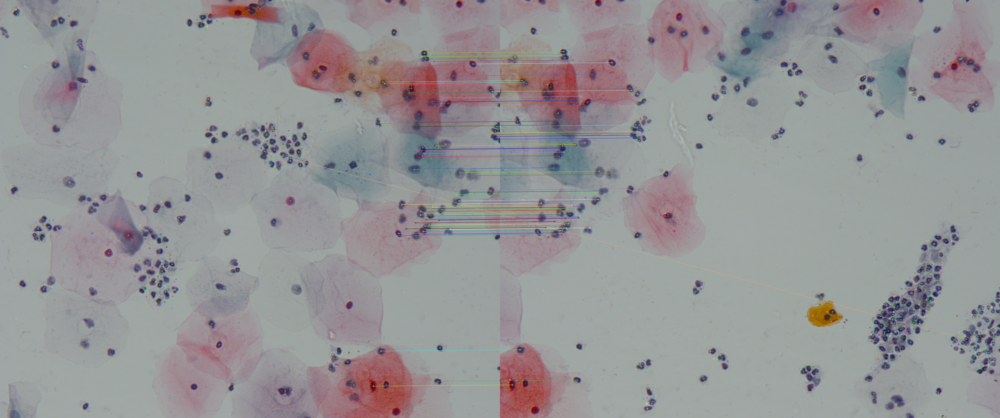

In [ ]:
i = 1
des1 = des_list_surf[i]
des2 = des_list_surf[i+1]

distance_ratio = 0.6
match = match_features(des1, des2, distance_ratio)

print("Number of features matched in frames {0} and {1} before filtering by distance: {2}".format(i, i+1, len(match)))

res = cv2.drawMatches(images[i], kp_list_surf[i], images[i+1], kp_list_surf[i+1], match, None)
cv2_imshow(res)

## Compute matches over all images

This method will find the best matches using the function ```match_features``` sending the current image and the next, for example: for image 2 and 3, then for image 3 and 4 and so on.

In [ ]:
def match_features_dataset(images, des_list, match_features, distance_ratio = 0.8):
    matches = []
    
    for i in range(len(images) - 1):
        des1 = des_list[i]
        des2 = des_list[i + 1]
        match = match_features(des1, des2, distance_ratio)
        matches.append(match)

    return matches

In [ ]:
distance_ratio = 0.65
matches = match_features_dataset(images, des_list_surf, match_features, distance_ratio)

i = 1
print("Number of features matched in frames {0} and {1}: {2}".format(i, i+1, len(matches[i])))

Number of features matched in frames 1 and 2: 97


## Compute size of new canvas

This method will find the corners to create the new canvas in order to stitch the base image with the next one.

In [ ]:
def compute_boundaries(corners_1, corners_2):
  # Concatenate all points (base image and next image mapped)
  all_points = np.concatenate((corners_1,corners_2), axis=0)
  # Compute size of new image
  [x_min, y_min] = np.int32(all_points.min(axis=0) - 0.5)
  [x_max, y_max] = np.int32(all_points.max(axis=0) + 0.5)
  return x_min, y_min, x_max, y_max

## Compute homography and stitch images

This loop aims to create the final stitching. It is based on homography computations of the "next" image in order to calculate the size of the canvas at each iteration to avoid memory overflows. 

An empty canvas is create at each iteration with the maximum (**x, y**) size found based on the previous canvas and the next image to add mapped with the homography in the "canvas". The images are added in the canvas in a masked fashioned where the first image is added with a mask that avoids copying pixels that overlap with the next image. Finally the "next image" is directly added to the canvas without masking.

The homography matrices are stacked up at each iteration considering that the images follow a consecutive pattern. These are stored in the variable *H_i*. The final result is saved in a temporal variable as it is not possible to show it due to memory constrains. 

In [ ]:
MIN_MATCH_COUNT = 10

# Identity matrix to concatenate homography
H_i = np.eye(3)
# Base image
base_image = images[0].copy()

stitching_time_surf = 0
#start = time.time()
for i in range(len(images) - 1):
  start = time.time()
  match = matches[i]
  kp1 = kp_list_surf[i]
  kp2 = kp_list_surf[i + 1]
  # Dst image
  img_dst = images[i + 1]
  # Corners of image dst
  dst_height, dst_width = img_dst.shape[:2]
  dst_corners = np.float32([[0, 0], [0, dst_height], [dst_width, dst_height], 
                           [dst_width, 0]]).reshape(-1,1,2)
  # Corners of image src
  src_height, src_width = base_image.shape[:2]
  src_corners = np.float32([[0, 0], [0, src_height], [src_width, src_height], 
                           [src_width, 0]]).reshape(4,-1)

  if len(match) > MIN_MATCH_COUNT:
    # Fuente es Query, destino es train
    # queryIdx are for kp1 and trainIdx for kp2 generates error
    src_pts = np.float32([kp1[m.queryIdx].pt for m in match]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in match]).reshape(-1, 1, 2)
    # RANSAC Threshold 5
    H, status = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, 5.0)
    # Concatenating homography
    H_i = H_i.dot(H)
    # Obtain position of the next image in Canvas
    dst_corners = cv2.perspectiveTransform(dst_corners, H_i).reshape(4, -1)
    # Coordinates of the new canvas
    x_min, y_min, x_max, y_max = compute_boundaries(src_corners, dst_corners)
    # Compute Homography for traslation in new canvas
    H_traslation = np.eye(3)
    if ( x_min < 0 ):
      H_traslation[0,2] += -x_min
      # This is the X dimension of the new image
      x_max += -x_min
    if ( y_min < 0 ):
      H_traslation[1,2] += -y_min
      # This is the Y dimension of the new image
      y_max += -y_min
    # Create canvas with new image size
    height = y_max
    width = x_max
    print('The currend height of the canvas is:  {} and the width is: {}'.format(height, width))
    # New canvas 
    img_panorama = np.zeros((height, width, 3))
    # Translate base image in new canvas
    base_image = cv2.warpPerspective(src = base_image, M = H_traslation, dsize = (width, height))
    # Concatenate traslation to homographies
    H_i = H_i.dot(H_traslation)
    # Map next image to new canvas
    next_image = cv2.warpPerspective(src = img_dst, M = H_i, dsize = (width, height))
    # Create mask to add images
    (ret, mask) = cv2.threshold(cv2.cvtColor(next_image, cv2.COLOR_BGR2GRAY), 0, 255, cv2.THRESH_BINARY)
    # Add base image to canvas
    img_panorama = cv2.add(img_panorama, base_image, mask = np.bitwise_not(mask), dtype = cv2.CV_8U)
    # Add next image to canvas
    result = cv2.add(img_panorama, next_image, dtype = cv2.CV_8U)
    base_image = result.copy()
    end = time.time()
    stitching_time_surf += end - start

cv2.imwrite('final_image_surf.jpg', base_image) 

The currend height of the canvas is:  3565 and the width is: 2930
The currend height of the canvas is:  3594 and the width is: 4255
The currend height of the canvas is:  3679 and the width is: 4808
The currend height of the canvas is:  3706 and the width is: 6725
The currend height of the canvas is:  3706 and the width is: 6725
The currend height of the canvas is:  3719 and the width is: 8051
The currend height of the canvas is:  3800 and the width is: 8745
The currend height of the canvas is:  3815 and the width is: 10820
The currend height of the canvas is:  3815 and the width is: 10820
The currend height of the canvas is:  3815 and the width is: 11925
The currend height of the canvas is:  3815 and the width is: 12797
The currend height of the canvas is:  3815 and the width is: 14730
The currend height of the canvas is:  3840 and the width is: 14730
The currend height of the canvas is:  3863 and the width is: 15553
The currend height of the canvas is:  3863 and the width is: 16588
Th

True

## Best image SURF

This was the best result obtained with a distance ratio of *0.65*. Nevertheless, it is important to recall that at every new execution, the features change as the descriptors and mathes. Therefore, we recommend to execute the code with a distance ratio of *0.7* which seems to produce the most *stable* stitch.

The image can be downloaded [here](https://github.com/MikeS96/cv_dl/blob/main/lab1/assets/best_image_surf.jpg). 

## 1.b Data for comparison
This section is used to find the data to compare both descriptors; number of features computed for 2 images, time required for this computation and matched features.

In [ ]:
# Set table
table = Table(title="Comparison SURF")

table.add_column("Descriptor", justify="center", style="cyan", no_wrap=True)
table.add_column("Images Size", style="magenta")
table.add_column("Keypoints image 1", style="magenta")
table.add_column("Keypoints image 2", style="magenta")
table.add_column("Execution time (s)", style="magenta")
table.add_column("Matches", justify="center", style="green")

total_time = 0
distance_ratio = 0.6

list_matches = []
list_kp1 = []
list_kp2 = []

for idx in range(len(images) - 1):
  start = time.time()
  kp1, des1 = extract_features_surf(images[idx])
  kp2, des2 = extract_features_surf(images[idx + 1])
  match = match_features(des1, des2, distance_ratio)
  end = time.time()
  table.add_row("SURF", '{}'.format(images[idx].shape[:2]), '{}'.format(len(kp1)), '{}'.format(len(kp2)), 
                '{}'.format(round(end - start, 2)), '{}'.format(len(match)))
  total_time += end - start
  list_kp1.append(len(kp1))
  list_kp2.append(len(kp2))
  list_matches.append(len(match))

table.add_row('', '', '{}'.format(round(sum(list_kp1) / len(list_kp1), 2)), '{}'.format(round(sum(list_kp2) / len(list_kp2), 2)), '{}'.format(round(total_time, 2)), 
              '{}'.format(round(sum(list_matches) / len(list_matches), 2)))
console = Console()
console.print(table)

## MSE and PSNR

The MSE was computing using the distance between pixels. This was done through the homography matrix, mapping the points of the next image to base image. The mapped points should be exactly the same as the ones from the base image as we are only mapping the *matches* between both images.

The MSE equation used is the one shown as follows:

$ MSE = \frac{1}{n}\sum_{t=1}^{n}(y - \hat{y})^2$ 

where $n$ are the number of matches between both images, $y$ are the points in the base image and $\hat{y}$ are the points in the next image. Additionally, the PSNR was also computed using the next equation.

$ PSNR = 10 log_{10} \frac{MAX^2_I}{MSE} $

It is important to mention that in this particular case, we computed the MSE over the $Norm$ of a point, the $x$ pixel value and the $y$ pixel value. That was with the intention to see which was the greatest source of error. The variable $MAX^2_I$ for the *norm* case if the maximum value of the norm given the image size, for *x* is the width of the image and for *y* is the height.

**Note:** The Errors were computed only using the inliers. As computing the MSE with the outliers lead to extremelly high error in the order of thousands as the difference was considerably increased by the MSE calculation.

In [ ]:
# Set table magnitude
table_m = Table(title = "MSE magnitude Error using SURF")

table_m.add_column("Images", justify="center", style="cyan", no_wrap=True)
table_m.add_column("MSE (px)", justify="center", style="magenta", no_wrap=True)
table_m.add_column("PSNR (dB)", justify="center", style="magenta", no_wrap=True)
table_m.add_column("Total time (s)", justify="center", style="green", no_wrap=True)
# Set table x
table_x = Table(title = "MSE X Error using SURF")

table_x.add_column("Images", justify="center", style="cyan", no_wrap=True)
table_x.add_column("MSE (px)" , justify="center", style="magenta", no_wrap=True)
table_x.add_column("PSNR (dB)", justify="center", style="magenta", no_wrap=True)
table_x.add_column("Total time (s)", justify="center", style="green", no_wrap=True)
# Set table Y
table_y = Table(title = "MSE Y Error using SURF")

table_y.add_column("Images", justify="center", style="cyan", no_wrap=True)
table_y.add_column("MSE (px)", justify="center", style="magenta", no_wrap=True)
table_y.add_column("PSNR (dB)", justify="center", style="magenta", no_wrap=True)
table_y.add_column("Total time (s)", justify="center", style="green", no_wrap=True)

total_mse_m = 0
total_mse_x = 0
total_mse_y = 0
total_psnr_m = 0
total_psnr_x = 0
total_psnr_y = 0

for i in range(len(images) - 1):
  match = matches[i]
  kp1 = kp_list_surf[i]
  kp2 = kp_list_surf[i + 1]
  inliers_dst = []
  inliers_src = []

  if len(match) > MIN_MATCH_COUNT:
    # Fuente es Query, destino es train
    # queryIdx are for kp1 and trainIdx for kp2 generates error
    src_pts = np.float32([kp1[m.queryIdx].pt for m in match]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m.trainIdx].pt for m in match]).reshape(-1, 1, 2)
    # RANSAC Threshold 5
    H, status = cv2.findHomography(dst_pts, src_pts, cv2.RANSAC, 5.0)
    for id_mask, dst_pt, src_pt in zip(status, dst_pts, src_pts):
      if id_mask.ravel() == 1:
        inliers_dst.append(dst_pt.ravel())
        inliers_src.append(src_pt.ravel())
    # Append inliers
    src_pts = np.array(inliers_src).reshape(-1, 1, 2)
    dst_pts = np.array(inliers_dst).reshape(-1, 1, 2)
    # Map points to base
    dst_pts2src = cv2.perspectiveTransform(dst_pts, H).reshape(-1, 2)
    src_pts = src_pts.reshape(-1, 2)
    MSE_M = (sum(np.square(np.linalg.norm(dst_pts2src, axis = 1) - np.linalg.norm(src_pts, axis = 1)))) / src_pts.shape[0]
    MSE_X = (sum(np.square(dst_pts2src[:, 0] - src_pts[:, 0]))) / src_pts.shape[0]
    MSE_Y = (sum(np.square(dst_pts2src[:, 1] - src_pts[:, 1]))) / src_pts.shape[0]
    # Computing max values
    im_height = images[0].shape[1]
    im_width = images[0].shape[0]
    im_norm = np.linalg.norm([images[0].shape[1], images[0].shape[0]])
    # Computing PSNR
    PSNR_M = 10 * np.log10(np.square(im_norm) / MSE_M)
    PSNR_X = 10 * np.log10(np.square(im_width) / MSE_X)
    PSNR_Y = 10 * np.log10(np.square(im_height) / MSE_Y)
    total_mse_m += MSE_M
    total_mse_x += MSE_X
    total_mse_y += MSE_Y
    total_psnr_m += PSNR_M
    total_psnr_x += PSNR_X
    total_psnr_y += PSNR_Y
    table_m.add_row("Image {} and {}".format(i, i+1), '{}'.format(round(MSE_M, 2)), '{}'.format(round(PSNR_M, 2)), '{}'.format(''))
    table_x.add_row("Image {} and {}".format(i, i+1), '{}'.format(round(MSE_X, 2)), '{}'.format(round(PSNR_X, 2)), '{}'.format(''))
    table_y.add_row("Image {} and {}".format(i, i+1), '{}'.format(round(MSE_Y, 2)), '{}'.format(round(PSNR_Y, 2)), '{}'.format(''))

table_m.add_row("{}".format(''), '{}'.format(round(total_mse_m / (len(images) - 1), 2)), '{}'.format(round(total_psnr_m / (len(images) - 1), 2)), '{}'.format(round(stitching_time_surf, 2)))
table_x.add_row("{}".format(''), '{}'.format(round(total_mse_x / (len(images) - 1), 2)), '{}'.format(round(total_psnr_x / (len(images) - 1), 2)), '{}'.format(round(stitching_time_surf, 2)))
table_y.add_row("{}".format(''), '{}'.format(round(total_mse_y / (len(images) - 1), 2)), '{}'.format(round(total_psnr_y / (len(images) - 1), 2)), '{}'.format(round(stitching_time_surf, 2)))
# Printing
console = Console()
console.print(table_m)
console.print(table_x)
console.print(table_y)

# Compare SIFT vs SURF


## Comparison between features, execution time and matches

```
                                    SIFT                                 
┏━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Descriptor ┃ Images Size ┃ Keypoints   ┃ Keypoints   ┃ Execution   ┃ Matches ┃
┃            ┃             ┃ image 1     ┃ image 2     ┃ time (s)    ┃         ┃
┡━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━┩
│    SIFT    │ (2048,      │ 786         │ 831         │ 2.91        │   55    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 831         │ 1174        │ 2.6         │   99    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 1174        │ 786         │ 2.66        │   105   │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 786         │ 403         │ 2.53        │   51    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 403         │ 1308        │ 2.55        │   18    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 1308        │ 525         │ 2.58        │   51    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 525         │ 441         │ 2.53        │   37    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 441         │ 235         │ 2.51        │   23    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 235         │ 294         │ 2.46        │   18    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 294         │ 882         │ 2.57        │   40    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 882         │ 796         │ 2.64        │   67    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 796         │ 1166        │ 2.61        │   171   │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 1166        │ 1272        │ 2.65        │   40    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 1272        │ 587         │ 2.61        │   125   │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 587         │ 756         │ 2.56        │   59    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 756         │ 604         │ 2.56        │   127   │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 604         │ 691         │ 2.53        │   129   │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 691         │ 547         │ 2.57        │   116   │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 547         │ 679         │ 2.53        │   55    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 679         │ 440         │ 2.53        │   38    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 440         │ 621         │ 2.51        │   35    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 621         │ 396         │ 2.52        │   67    │
│            │ 2448)       │             │             │             │         │
│    SIFT    │ (2048,      │ 396         │ 502         │ 2.5         │   39    │
│            │ 2448)       │             │             │             │         │
│            │             │ 705.22      │ 692.87      │ 59.19       │  68.04  │
└────────────┴─────────────┴─────────────┴─────────────┴─────────────┴─────────┘                                      
```

To assess SIFT, consecutive pair of images where used in order to compute the features between them, execution time and matches (after filtering). Overall, it is possible to see that almost all the pair of images in the dataset have similar amount of features. The average number of features for SIFT are **705** for the first image and **692.87** which is a reasonable amount of features to compute matches between. Similarly, the average number of matches was **68** which are more than enough to compute an homography matrix. The execution time of the feature extraction/matching part was roughly **2.53 seconds**. The minimmum amount of features obtained with SIFT were **235** and the minimum number of matches **18** which are both more than enough to compute the homography matrix. This data was computed using a distance ratio of **0.6**

**Note:** The results presented thereby can change over each iteration but remain quite similar.

```
                                    SURF                                 
┏━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━━━━━┳━━━━━━━━━┓
┃ Descriptor ┃ Images Size ┃ Keypoints   ┃ Keypoints   ┃ Execution   ┃ Matches ┃
┃            ┃             ┃ image 1     ┃ image 2     ┃ time (s)    ┃         ┃
┡━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━━━━━╇━━━━━━━━━┩
│    SURF    │ (2048,      │ 720         │ 806         │ 2.72        │   55    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 806         │ 1273        │ 2.92        │   82    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 1273        │ 721         │ 2.85        │   96    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 721         │ 378         │ 2.39        │   44    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 378         │ 1466        │ 2.62        │   15    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 1466        │ 433         │ 2.7         │   47    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 433         │ 427         │ 2.3         │   36    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 427         │ 193         │ 2.21        │   27    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 193         │ 241         │ 1.95        │   16    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 241         │ 697         │ 2.29        │   41    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 697         │ 716         │ 2.62        │   42    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 716         │ 1068        │ 3.01        │   148   │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 1068        │ 1067        │ 3.16        │   24    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 1067        │ 497         │ 2.82        │   101   │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 497         │ 781         │ 2.53        │   55    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 781         │ 560         │ 2.52        │   114   │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 560         │ 660         │ 2.53        │   85    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 660         │ 461         │ 2.51        │   96    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 461         │ 665         │ 2.45        │   47    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 665         │ 395         │ 2.43        │   30    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 395         │ 489         │ 2.38        │   21    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 489         │ 333         │ 2.36        │   45    │
│            │ 2448)       │             │             │             │         │
│    SURF    │ (2048,      │ 333         │ 431         │ 2.33        │   32    │
│            │ 2448)       │             │             │             │         │
│            │             │ 654.22      │ 641.65      │ 58.62       │  56.48  │
└────────────┴─────────────┴─────────────┴─────────────┴─────────────┴─────────┘
```

To assess SURF the same process of SURF was performed. Overall, it is possible to see that almost all the pair of images in the dataset have similar amount of features. The average number of features for SURF are **654** for the first image and **641** which is a reasonable amount of features to compute matches between. Similarly, the average number of matches was **56** which are more than enough to compute an homography matrix. The execution time of the feature extraction/matching part was roughly **2.2 seconds**. The minimmum amount of features obtained with SURF were **193** and the minimum number of matches **15** which are both more than enough to compute the homography matrix. This data was computed using a distance ratio of **0.6**

<font color='blue'>**Comparison** </font>

Overall, both detector/descriptors behave quite similar. Both take roughly the same time, for SURF **58** seconds and SIFT **59** seconds to compute the features/matches over the whole dataset, however, SURF is just a little bit faster. The number of features are also similar, the ones computed by SURF are easily changed through the hessian threshold where higher values mean less features. Finally, SURF computes less matches when compared with SIFT as the average number of matches computed by SURF is less by roughly ten points than SIFT.

Both techniques work well, nevertheless, the best *visual* result was produced by SIFT as shown in previous cells.

## Comparison between MSE and PSNR

```
              MSE magnitude Error using SIFT               
┏━━━━━━━━━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┓
┃     Images      ┃ MSE (px) ┃ PSNR (dB) ┃ Total time (s) ┃
┡━━━━━━━━━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━━━━━━┩
│  Image 0 and 1  │   0.68   │   71.73   │                │
│  Image 1 and 2  │   0.6    │   72.3    │                │
│  Image 2 and 3  │   0.18   │   77.61   │                │
│  Image 3 and 4  │   0.54   │   72.74   │                │
│  Image 4 and 5  │   0.13   │   79.09   │                │
│  Image 5 and 6  │   0.63   │   72.11   │                │
│  Image 6 and 7  │   0.38   │   74.26   │                │
│  Image 7 and 8  │   0.43   │   73.73   │                │
│  Image 8 and 9  │   0.07   │   81.55   │                │
│ Image 9 and 10  │   0.24   │   76.28   │                │
│ Image 10 and 11 │   0.29   │   75.46   │                │
│ Image 11 and 12 │   0.54   │   72.75   │                │
│ Image 12 and 13 │   0.35   │   74.67   │                │
│ Image 13 and 14 │   0.64   │   72.03   │                │
│ Image 14 and 15 │   0.16   │   78.05   │                │
│ Image 15 and 16 │   0.29   │   75.45   │                │
│ Image 16 and 17 │   0.19   │   77.26   │                │
│ Image 17 and 18 │   0.74   │   71.37   │                │
│ Image 18 and 19 │   0.34   │   74.73   │                │
│ Image 19 and 20 │   0.37   │   74.42   │                │
│ Image 20 and 21 │   0.19   │   77.29   │                │
│ Image 21 and 22 │   0.4    │   74.01   │                │
│ Image 22 and 23 │   0.2    │   77.1    │                │
│                 │   0.37   │   75.04   │     65.63      │
└─────────────────┴──────────┴───────────┴────────────────┘
```

For the sake of readability, we will only compare the MSE error over the norm of a point. For further information please check the cells above where more tables are provided with MSE error over the **x and y** pixel values of matches.

The MSE presents the error between pixel distance in the same reference frame (mapped through homography) and the Peak Signal-to-Noise Ratio (PSNR) is a measured of error that avoids the problem of scale by higher values.

For SIFT, the MSE is higher than with SURF, with an average value of **0.37**. 
This value was computed using only inliers and that is why it is so low and close to zero. This result demonstrates that the points used to compute the homography matrix are nearly identical and therefore, the mapping should be reliable. From the other MSE tables, it is possible to validate that the **x** pixel values is most prone to produce error rather than **y** pixel values.

Similarly, the PSNR error is in average of **75.04** (higher values are better) for the whole dataset. This value demonstrates that the SIFT algorithms is good performing the task of image stitching thorugh homography matrices.

```
              MSE magnitude Error using SURF               
┏━━━━━━━━━━━━━━━━━┳━━━━━━━━━━┳━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┓
┃     Images      ┃ MSE (px) ┃ PSNR (dB) ┃ Total time (s) ┃
┡━━━━━━━━━━━━━━━━━╇━━━━━━━━━━╇━━━━━━━━━━━╇━━━━━━━━━━━━━━━━┩
│  Image 0 and 1  │   0.35   │   74.67   │                │
│  Image 1 and 2  │   0.5    │   73.13   │                │
│  Image 2 and 3  │   0.13   │   78.84   │                │
│  Image 3 and 4  │   0.29   │   75.52   │                │
│  Image 4 and 5  │   0.15   │   78.32   │                │
│  Image 5 and 6  │   0.18   │   77.48   │                │
│  Image 6 and 7  │   0.1    │   80.19   │                │
│  Image 7 and 8  │   0.1    │   80.17   │                │
│  Image 8 and 9  │   0.2    │   76.98   │                │
│ Image 9 and 10  │   0.34   │   74.75   │                │
│ Image 10 and 11 │   0.64   │   72.03   │                │
│ Image 11 and 12 │   0.32   │   74.98   │                │
│ Image 12 and 13 │   0.25   │   76.11   │                │
│ Image 13 and 14 │   0.33   │   74.86   │                │
│ Image 14 and 15 │   0.12   │   79.32   │                │
│ Image 15 and 16 │   0.18   │   77.48   │                │
│ Image 16 and 17 │   0.31   │   75.19   │                │
│ Image 17 and 18 │   0.76   │   71.27   │                │
│ Image 18 and 19 │   0.59   │   72.39   │                │
│ Image 19 and 20 │   0.19   │   77.38   │                │
│ Image 20 and 21 │   0.66   │   71.88   │                │
│ Image 21 and 22 │   0.54   │   72.77   │                │
│ Image 22 and 23 │   0.36   │   74.53   │                │
│                 │   0.33   │   75.66   │      50.4      │
└─────────────────┴──────────┴───────────┴────────────────┘
```

A similar behavior as the one described with SIFT is presented with SURF. Values of MSE are presented with an average of **0.33** and a PSNR of **75.66**. In fact, the results presented by SURF are slightly better than SIFT by roughly **0.04** This data was computed using a distance ratio of **0.6**

<font color='blue'>**Comparison** </font>

Overall, SURF is roughly **15** seconds faster than SIFT through the stitching process which confirms the theory that SURF works faster than SIFT. Additionally both MSE and PSNR are better with SURF using the same *distance ratio* value. However, a really interesting pattern occurs here as visualizing the final result of the stitch for [SIFT](https://github.com/MikeS96/cv_dl/blob/main/lab1/assets/best_image_sift.jpg) and [SURF](https://github.com/MikeS96/cv_dl/blob/main/lab1/assets/best_image_surf.jpg). The image of SIFT seems way better than the final result of SURF, however, the final size of SIFT's image is around 17Mb compared with SURF that is around 14Mb. 

Additionally, the final images size are way different, the final size of SIFT for width are roughty 29k pixels and for SIFT 22K pixels, which is a considerable difference and the reason why SURF performs faster in the stitching part.

To conclude, both detector/descriptors work well, SURF has the lowest MSE and PSNR error and it also wins in both computation speed and errors. Nevertheless, the final result provided by SIFT seems to be (*visually*) the best.